# Essential Machine Learning and Exploratory Data Analysis with Python and Jupyter Notebook





## Pragmatic AI Labs
![alt text](https://paiml.com/images/logo_with_slogan_white_background.png)

This notebook was produced by [Pragmatic AI Labs](https://paiml.com/).  You can continue learning about these topics by:

*   Buying a copy of [Pragmatic AI: An Introduction to Cloud-Based Machine Learning](http://www.informit.com/store/pragmatic-ai-an-introduction-to-cloud-based-machine-9780134863917)
*   Reading an online copy of [Pragmatic AI:Pragmatic AI: An Introduction to Cloud-Based Machine Learning](https://www.safaribooksonline.com/library/view/pragmatic-ai-an/9780134863924/)
*   Viewing more content at [noahgift.com](https://noahgift.com/)


# Part 2.1: IO Operations in Python and Pandas and ML Project Exploration

## Working with Files

### Writing to a file

In [1]:
f = open('workfile.txt', 'w')
f.write("foo")
f.close()
!cat workfile.txt
!ls -l

foototal 8
drwxr-xr-x 3 root root 4096 Jul 26 16:56 datalab
-rw-r--r-- 1 root root    3 Jul 29 16:49 workfile.txt


### Writing to a file with 'context'

In [2]:
with open("workfile.txt", "w") as workfile:
    workfile.write("bam")
!cat workfile.txt

bam

### Reading a file in


In [3]:
f = open("workfile.txt", "r")
out = f.readlines()
f.close()
print(out)

['bam']


### Reading a file with 'context'

In [4]:
with open("workfile.txt", "r") as workfile:
    #print(workfile.readlines())
    print(workfile.read())


bam


## Serialization Techniques


### Serialize a Python Dictionary to Pickle

In [0]:
mydict = {"one":1, "two":2}

In [0]:
import pickle

In [0]:
pickle.dump(mydict, open('mydictionary.pickle', 'wb'))

In [8]:
!ls -l mydictionary.pickle

-rw-r--r-- 1 root root 32 Jul 29 16:49 mydictionary.pickle


In [9]:
!cat mydictionary.pickle

�}q (X   oneqKX   twoqKu.

In [0]:
res = pickle.load(open('mydictionary.pickle', "rb"))

In [11]:
print(res)

{'one': 1, 'two': 2}


### Serialize a Python Dictionary to JSON


In [0]:
import json
with open('data.json', 'w') as outfile:
    json.dump(res, outfile)

In [13]:
!cat data.json

{"one": 1, "two": 2}

In [0]:
with open('data.json', 'rb') as outfile:
    res2 = json.load(outfile)

In [15]:
print(res2)
type(res2)

{'one': 1, 'two': 2}


dict

### Save to Yaml

In [0]:
import yaml

In [0]:
with open("data.yaml", "w") as yamlfile:                                               
    yaml.safe_dump(res2, yamlfile, default_flow_style=False)

In [18]:
!cat data.yaml

one: 1
two: 2


### Load Yaml

In [0]:
with open("data.yaml", "rb") as yamlfile:                                               
    res3 = yaml.safe_load(yamlfile) 

In [20]:
print(res3)
type(res3)

{'one': 1, 'two': 2}


dict

## Use Pandas DataFrames

#### Creating Pandas DataFrames

##### Creating DataFrames CSV file



*   Can be local
*   Can be hosted on a website



In [21]:
import pandas as pd
mma_df = pd.read_csv('../data/ufc_fights_all.csv')
mma_df.head()

,pageurl,eid,mid,event_name,event_org,event_date,event_place,f1pageurl,f2pageurl,f1name,f2name,f1result,f2result,f1fid,f2fid,method,method_d,ref,round,time
0,/events/UFC-1-The-Beginning-7,7,8,UFC 1 - The Beginning,Ultimate Fighting Championship,11/12/93,"McNichols Arena, Denver, Colorado, United States",/fighter/Royce-Gracie-19,/fighter/Gerard-Gordeau-15,Royce Gracie,Gerard Gordeau,win,loss,19,15,Submission,Rear-Naked Choke,Helio Vigio,1,1:44
1,/events/UFC-1-The-Beginning-7,7,7,UFC 1 - The Beginning,Ultimate Fighting Championship,11/12/93,"McNichols Arena, Denver, Colorado, United States",/fighter/Jason-DeLucia-22,/fighter/Trent-Jenkins-23,Jason DeLucia,Trent Jenkins,win,loss,22,23,Submission,Rear-Naked Choke,Joao Alberto Barreto,1,0:52
2,/events/UFC-1-The-Beginning-7,7,6,UFC 1 - The Beginning,Ultimate Fighting Championship,11/12/93,"McNichols Arena, Denver, Colorado, United States",/fighter/Royce-Gracie-19,/fighter/Ken-Shamrock-4,Royce Gracie,Ken Shamrock,win,loss,19,4,Submission,Rear-Naked Choke,Helio Vigio,1,0:57
3,/events/UFC-1-The-Beginning-7,7,5,UFC 1 - The Beginning,Ultimate Fighting Championship,11/12/93,"McNichols Arena, Denver, Colorado, United States",/fighter/Gerard-Gordeau-15,/fighter/Kevin-Rosier-17,Gerard Gordeau,Kevin Rosier,win,loss,15,17,TKO,Corner Stoppage,Joao Alberto Barreto,1,0:59
4,/events/UFC-1-The-Beginning-7,7,4,UFC 1 - The Beginning,Ultimate Fighting Championship,11/12/93,"McNichols Arena, Denver, Colorado, United States",/fighter/Ken-Shamrock-4,/fighter/Patrick-Smith-21,Ken Shamrock,Patrick Smith,win,loss,4,21,Submission,Heel Hook,Helio Vigio,1,1:49


##### List to Pandas DataFrame 

Convert a list to Pandas DataFrame

In [22]:
winning_technique_list = mma_df['method_d'].tolist()
techniques_df = pd.DataFrame(winning_technique_list)
techniques_df.columns = ["stoppage"]
techniques_df.head()

,stoppage
0,Rear-Naked Choke
1,Rear-Naked Choke
2,Rear-Naked Choke
3,Corner Stoppage
4,Heel Hook


##### Dictionary to Pandas DataFrame

Take dictionary full of dictionaries and make it a Pandas DataFrame

#### Exporting Pandas DataFrames

##### Pandas DataFrame Column to List

Can use "tolist"

In [23]:
winning_technique_list = mma_df['method_d'].tolist()
winning_technique_list[0:4]

['Rear-Naked Choke', 'Rear-Naked Choke', 'Rear-Naked Choke', 'Corner Stoppage']

##### Pandas DataFrame to Dictionary

Grab a couple of records and convert to Python dictionary

In [24]:
mma_dict = mma_df.head(2).to_dict()
mma_dict

{'eid': {0: 7, 1: 7},
 'event_date': {0: '11/12/93', 1: '11/12/93'},
 'event_name': {0: 'UFC 1 - The Beginning', 1: 'UFC 1 - The Beginning'},
 'event_org': {0: 'Ultimate Fighting Championship',
  1: 'Ultimate Fighting Championship'},
 'event_place': {0: 'McNichols Arena, Denver, Colorado, United States',
  1: 'McNichols Arena, Denver, Colorado, United States'},
 'f1fid': {0: 19, 1: 22},
 'f1name': {0: 'Royce Gracie', 1: 'Jason DeLucia'},
 'f1pageurl': {0: '/fighter/Royce-Gracie-19', 1: '/fighter/Jason-DeLucia-22'},
 'f1result': {0: 'win', 1: 'win'},
 'f2fid': {0: 15, 1: 23},
 'f2name': {0: 'Gerard Gordeau', 1: 'Trent Jenkins'},
 'f2pageurl': {0: '/fighter/Gerard-Gordeau-15',
  1: '/fighter/Trent-Jenkins-23'},
 'f2result': {0: 'loss', 1: 'loss'},
 'method': {0: 'Submission', 1: 'Submission'},
 'method_d': {0: 'Rear-Naked Choke', 1: 'Rear-Naked Choke'},
 'mid': {0: 8, 1: 7},
 'pageurl': {0: '/events/UFC-1-The-Beginning-7',
  1: '/events/UFC-1-The-Beginning-7'},
 'ref': {0: 'Helio Vigio',

##### Pandas DataFrame to CSV

Write out DataFrame using to_csv


In [25]:
mma_df.head().to_csv("small_mma_records.csv")
!cat small_mma_records.csv

,pageurl,eid,mid,event_name,event_org,event_date,event_place,f1pageurl,f2pageurl,f1name,f2name,f1result,f2result,f1fid,f2fid,method,method_d,ref,round,time
0,/events/UFC-1-The-Beginning-7,7,8,UFC 1 - The Beginning,Ultimate Fighting Championship,11/12/93,"McNichols Arena, Denver, Colorado, United States",/fighter/Royce-Gracie-19,/fighter/Gerard-Gordeau-15,Royce Gracie,Gerard Gordeau,win,loss,19,15,Submission,Rear-Naked Choke,Helio Vigio,1,1:44
1,/events/UFC-1-The-Beginning-7,7,7,UFC 1 - The Beginning,Ultimate Fighting Championship,11/12/93,"McNichols Arena, Denver, Colorado, United States",/fighter/Jason-DeLucia-22,/fighter/Trent-Jenkins-23,Jason DeLucia,Trent Jenkins,win,loss,22,23,Submission,Rear-Naked Choke,Joao Alberto Barreto,1,0:52
2,/events/UFC-1-The-Beginning-7,7,6,UFC 1 - The Beginning,Ultimate Fighting Championship,11/12/93,"McNichols Arena, Denver, Colorado, United States",/fighter/Royce-Gracie-19,/fighter/Ken-Shamrock-4,Royce Gracie,Ken Shamrock,win,loss,19,4,Submission,Rear

#### Using Pandas on Ray

More info on Pandas:  https://rise.cs.berkeley.edu/blog/pandas-on-ray/

#### Using Google Sheets with Pandas DataFrames

Reference:  [Official Google Colab Documentation on IO](https://colab.research.google.com/notebooks/io.ipynb)

**Install Google Spreadsheet Library**

In [0]:
!pip install --upgrade -q gspread

**Authenticate to API**

In [0]:
from google.colab import auth
auth.authenticate_user()

import gspread
from oauth2client.client import GoogleCredentials

gc = gspread.authorize(GoogleCredentials.get_application_default())

**Create a Spreadsheet and Put Items in It**

Note, could use existing spreadsheet

In [28]:
sh = gc.create('pramaticai-test')
worksheet = gc.open('pramaticai-test').sheet1
cell_list = worksheet.range('A1:A10')

import random
count = 0
for cell in cell_list:
  count +=1
  cell.value = count
worksheet.update_cells(cell_list)

{'spreadsheetId': '1ZJXQBeaQMvUz7qvJoY1y0I3dsZXTsUJtQnvB5s5GUxE',
 'updatedCells': 10,
 'updatedColumns': 1,
 'updatedRange': 'Sheet1!A1:A10',
 'updatedRows': 10}

**Convert Spreadsheet Data to Pandas DataFrame**

In [29]:
worksheet = gc.open('pramaticai-test').sheet1
rows = worksheet.get_all_values()
import pandas as pd
df = pd.DataFrame.from_records(rows)
df.head()

,0
0,1
1,2
2,3
3,4
4,5


## Concurrency in Python

#### Threads

Threads are the beatup Pinto of concurrency in Python.  They lack the ability to scale to multiple cores and often cause performance problems.  Almost always you should choose some other method of concurrency in Python.

*Typically they are used in situations where things are IO bound, not CPU bound.*

![Pinto](https://homeprohub.files.wordpress.com/2013/03/cost-of-window-replacement.jpg)





##### Simple Threading Example

In [30]:
import threading

def fight_club(x):
  
    print(f"Processing Thread# {num}: Calculating punch with attack strength {x} to the {x} power\n")
    return x**x
  
workers = []
for num in range(1,6):
  print(f"Queuing thread # {num}\n")
  thread = threading.Thread(target=fight_club, args=(num,))
  workers.append(thread)
  thread.start()

Queuing thread # 1

Queuing thread # 2

Processing Thread# 1: Calculating punch with attack strength 1 to the 1 power

Processing Thread# 2: Calculating punch with attack strength 2 to the 2 power

Queuing thread # 3
Processing Thread# 3: Calculating punch with attack strength 3 to the 3 power


Processing Thread# 4: Calculating punch with attack strength 4 to the 4 power
Queuing thread # 4

Queuing thread # 5
Processing Thread# 5: Calculating punch with attack strength 5 to the 5 power




#### Using the subprocess command

A general purpose way to "Shell Out" to system commands


In [31]:
import subprocess
res = subprocess.Popen("ls -l", shell=True, stdout=subprocess.PIPE)
out = res.stdout.readlines()
print(out)
!ls -l

[b'total 28\n', b'-rw-r--r-- 1 root root   20 Jul 29 16:49 data.json\n', b'drwxr-xr-x 1 root root 4096 Jul 29 16:51 datalab\n', b'-rw-r--r-- 1 root root   14 Jul 29 16:49 data.yaml\n', b'-rw-r--r-- 1 root root   32 Jul 29 16:49 mydictionary.pickle\n', b'-rw-r--r-- 1 root root 1604 Jul 29 16:49 small_mma_records.csv\n', b'-rw-r--r-- 1 root root    3 Jul 29 16:49 workfile.txt\n']
total 28
-rw-r--r-- 1 root root   20 Jul 29 16:49 data.json
drwxr-xr-x 1 root root 4096 Jul 29 16:51 datalab
-rw-r--r-- 1 root root   14 Jul 29 16:49 data.yaml
-rw-r--r-- 1 root root   32 Jul 29 16:49 mydictionary.pickle
-rw-r--r-- 1 root root 1604 Jul 29 16:49 small_mma_records.csv
-rw-r--r-- 1 root root    3 Jul 29 16:49 workfile.txt


In [32]:
!ls -l

total 28
-rw-r--r-- 1 root root   20 Jul 29 16:49 data.json
drwxr-xr-x 1 root root 4096 Jul 29 16:51 datalab
-rw-r--r-- 1 root root   14 Jul 29 16:49 data.yaml
-rw-r--r-- 1 root root   32 Jul 29 16:49 mydictionary.pickle
-rw-r--r-- 1 root root 1604 Jul 29 16:49 small_mma_records.csv
-rw-r--r-- 1 root root    3 Jul 29 16:49 workfile.txt


### Multiprocessing

#### Mapping processes to Functions

Processes are forked and run truly parallel (unlike threads)

In [33]:
from multiprocessing import Pool
import datetime
import time
import random

def fight_club(x):
  
    sleep_time = random.randrange(0,3)
    time.sleep(sleep_time)
    timestamp = datetime.datetime.now()
    print(f"Calculating punch with attack strength {x} to the {x} power: @timestamp {timestamp} with sleep {sleep_time}")
    return x**x

if __name__ == '__main__':
    p = Pool(5)
    print(p.map(fight_club, [1, 2, 3]))

Calculating punch with attack strength 1 to the 1 power: @timestamp 2018-07-29 16:51:26.198554 with sleep 0
Calculating punch with attack strength 3 to the 3 power: @timestamp 2018-07-29 16:51:27.199509 with sleep 1
Calculating punch with attack strength 2 to the 2 power: @timestamp 2018-07-29 16:51:27.199509 with sleep 1
[1, 4, 27]


#### Process Pool Joined on Queue (Threadlike behavior)

Mimicks Threading interface, but with actual multi-core functionality

In [34]:
from multiprocessing import Process, Queue

def f(q):
    q.put(["armbar", "kimura",  "Mata Leão"])

if __name__ == '__main__':
    q = Queue()
    p = Process(target=f, args=(q,))
    p.start()
    print(f"Grabbing some attacks: {q.get()}")    
    p.join()

Grabbing some attacks: ['armbar', 'kimura', 'Mata Leão']


### Async IO in Python Examples

More info here:  https://docs.python.org/3/library/asyncio.html

**Using Python3 Async**

```python
import asyncio

def send_async_firehose_events(count=100):
    """Async sends events to firehose"""

    start = time.time() 
    client = firehose_client()
    extra_msg = {"aws_service": "firehose"}
    loop = asyncio.get_event_loop()
    tasks = []
    LOG.info(f"sending aysnc events TOTAL {count}",extra=extra_msg)
    num = 0
    for _ in range(count):
        tasks.append(asyncio.ensure_future(put_record(gen_uuid_events(), client)))
        LOG.info(f"sending aysnc events: COUNT {num}/{count}")
        num +=1
    loop.run_until_complete(asyncio.wait(tasks))
    loop.close()
    end = time.time()  
    LOG.info("Total time: {}".format(end - start))
  ```

**Using trollius library with Python 2:  DEPRECATED**

```python
"""Generates an Async MetaData call.  Note, this isn't available in Boto3
In [56]: res = all_metadata_async()
In [57]: res
Out[57]: 
[('ami-manifest-path', <Response [200]>),
 ('instance-type', <Response [200]>),
 ('instance-id', <Response [200]>),
 ('iam', <Response [200]>),
 ('local-hostname', <Response [200]>),
 ('network', <Response [200]>),
 ('hostname', <Response [200]>),
 ('ami-id', <Response [200]>),
 ('instance-action', <Response [200]>),
 ('profile', <Response [200]>),
 ('reservation-id', <Response [200]>),
 ('security-groups', <Response [200]>),
 ('metrics', <Response [200]>),
 ('mac', <Response [200]>),
 ('public-ipv4', <Response [200]>),
 ('services', <Response [200]>),
 ('local-ipv4', <Response [200]>),
 ('placement', <Response [200]>),
 ('ami-launch-index', <Response [200]>),
 ('public-hostname', <Response [200]>),
 ('public-keys', <Response [200]>),
 ('block-device-mapping', <Response [200]>)]
"""

import requests
import trollius

def get_metadata_api_urls():
    """Retrieves the api endpoints for metadata"""

    full_urls = {}
    metadata_url = "http://169.254.169.254/latest/meta-data/"
    resp = requests.get(metadata_url)
    urls = resp.content.split()
    for url in urls:
        stripped_url = url.rstrip("/")
        full_urls[stripped_url]=(os.path.join(metadata_url, url))
    return full_urls

def _get(key_url):
    key,url = key_url
    return key, requests.get(url)

def _do_calls(urls):
    loop = trollius.get_event_loop()
    futures = []
    for url in urls:
        futures.append(loop.run_in_executor(None, _get, url))
    return futures

@trollius.coroutine
def call():
    results = []
    futures = _do_calls(get_metadata_api_urls().items())
    for future in futures:
        result = yield trollius.From(future)
        results.append(result)
    raise trollius.Return(results)

def all_metadata_async():
    """Retrieves all available metadata for an instance async"""

    loop = trollius.get_event_loop()
    res = loop.run_until_complete(call())
   ```


###  AWS Lambda and Chalice

Standalone Lambda with Chalice:  http://chalice.readthedocs.io/en/latest/

```python
@app.lambda_function()
def send_message(event, context):
    """Send a message to a channel"""

    slack_client = SlackClient(SLACK_TOKEN)
    res = slack_client.api_call(
      "chat.postMessage",
      channel="#general",
      text=event
    )
    return res
```


### Larger Scale Concurrency



*   [AWS Step Functions with Lambda](https://aws.amazon.com/step-functions/)

![alt text](https://d1.awsstatic.com/product-marketing/Step%20Functions/OrderFullScreen.0e74c2f19d89a9325addb5bd746cd895b2e4c9c2.jpg)

*   [AWS Batch](https://aws.amazon.com/batch/)
![alt text](https://d1.awsstatic.com/Test%20Images/Kate%20Test%20Images/Dilithium_flowchart%20diagrams_v3_kw-02.322877d73eda8ed71a44db216a1d195550befac0.png)

*   [RabbitMQ Worker Farms-IBM Developerworks Article](https://www.ibm.com/developerworks/cloud/library/cl-optimizepythoncloud1/index.html)

![alt text](https://www.ibm.com/developerworks/cloud/library/cl-optimizepythoncloud2/figure1.gif)





## Walking through Social Power NBA EDA and ML Project

*[Read related material covered in Chapter 6 of Pragmatic AI](https://www.safaribooksonline.com/library/view/pragmatic-ai-an/9780134863924/ch06.xhtml#ch06)*

* Data Collection Sources
* Importing and merging DataFrames in Pandas 
* Creating correlation heatmaps 
* Using seaborn lmplot 
* Using linear regression in Python
* Using ggplot in Python 
* Doing KMeans clustering 
* Doing PCA with scikit-learn 
* Doing ML classification prediction with scikit-learn 
* Doing ML Regression prediction with scikit-learn 
* Using Plotly for interactive Data Visualization



#### Data Collection Sources 

![Collection of Data](https://user-images.githubusercontent.com/58792/40758183-e64ba7c4-6440-11e8-97c5-c408e0bc321e.png)

**Twitter Code:**

https://github.com/noahgift/socialpowernba/blob/master/socialpower/sptwitter.py

**Wikipedia Code:**

https://github.com/noahgift/socialpowernba/blob/master/socialpower/spwikipedia.py

#### Import and merge DataFrames in Pandas

In [35]:
import pandas as pd
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
%matplotlib inline

/usr/local/lib/python3.6/dist-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [36]:
attendance_df = pd.read_csv("../data/nba_2017_attendance.csv");attendance_df.head()

,TEAM,GMS,PCT,TOTAL_MILLIONS,AVG_MILLIONS
0,Chicago Bulls,41,104,0.888882,0.021680
1,Dallas Mavericks,41,103,0.811366,0.019789
2,Sacramento Kings,41,101,0.721928,0.017608
3,Miami Heat,41,100,0.805400,0.019643
4,Toronto Raptors,41,100,0.813050,0.019830


In [37]:
endorsement_df = pd.read_csv("../data/nba_2017_endorsements.csv");endorsement_df.head()

,NAME,TEAM,SALARY_MILLIONS,ENDORSEMENT_MILLIONS
0,LeBron James,Cleveland Cavaliers,31,55
1,Kevin Durant,Golden State Warriors,27,36
2,Stephen Curry,Golden State Warriors,12,35
3,James Harden,Houston Rockets,27,20
4,Russell Westbrook,Oklahoma City Thunder,27,15


In [38]:
valuations_df = pd.read_csv("../data/nba_2017_team_valuations.csv");valuations_df.head()

,TEAM,VALUE_MILLIONS
0,New York Knicks,3300.0
1,Los Angeles Lakers,3000.0
2,Golden State Warriors,2600.0
3,Chicago Bulls,2500.0
4,Boston Celtics,2200.0


In [39]:
salary_df = pd.read_csv("../data/nba_2017_salary.csv");salary_df.head()

,NAME,POSITION,TEAM,SALARY
0,LeBron James,SF,Cleveland Cavaliers,30963450.0
1,Mike Conley,PG,Memphis Grizzlies,26540100.0
2,Al Horford,C,Boston Celtics,26540100.0
3,Dirk Nowitzki,PF,Dallas Mavericks,25000000.0
4,Carmelo Anthony,SF,New York Knicks,24559380.0


In [40]:
pie_df = pd.read_csv("../data/nba_2017_pie.csv");pie_df.head()

,PLAYER,TEAM,AGE,GP,W,L,MIN,OFFRTG,DEFRTG,NETRTG,...,AST RATIO,OREB%,DREB%,REB%,TO RATIO,EFG%,TS%,USG%,PACE,PIE
0,Russell Westbrook,OKC,28,81,46,35,34.6,107.9,104.6,3.3,...,23.4,5.3,27.9,16.7,12.2,47.6,55.4,40.8,102.31,23.0
1,Boban Marjanovic,DET,28,35,16,19,8.4,104.3,102.4,1.9,...,5.1,16.6,31.3,23.9,5.7,54.5,60.6,24.8,97.20,19.6
2,Demetrius Jackson,BOS,22,5,1,4,3.4,124.2,117.8,6.3,...,31.1,9.1,11.8,10.3,0.0,87.5,75.3,17.2,87.46,19.4
3,Anthony Davis,NOP,24,75,31,44,36.1,104.2,102.5,1.7,...,7.3,6.7,26.9,17.0,8.4,51.8,58.0,32.6,100.19,19.2
4,James Harden,HOU,27,81,54,27,36.4,113.6,107.3,6.3,...,27.6,3.5,21.2,12.3,14.1,52.5,61.3,34.1,102.98,19.0


In [41]:
plus_minus_df = pd.read_csv("../data/nba_2017_real_plus_minus.csv");plus_minus_df.head()

,NAME,TEAM,GP,MPG,ORPM,DRPM,RPM,WINS
0,"LeBron James, SF",CLE,74,37.8,6.49,1.93,8.42,20.43
1,"Stephen Curry, PG",GS,79,33.4,7.27,0.14,7.41,18.80
2,"Jimmy Butler, SG",CHI,76,37.0,4.82,1.80,6.62,17.35
3,"Russell Westbrook, PG",OKC,81,34.6,6.74,-0.47,6.27,17.34
4,"Draymond Green, PF",GS,76,32.5,1.55,5.59,7.14,16.84


In [42]:
br_stats_df = pd.read_csv("../data/nba_2017_br.csv");br_stats_df.head()

,Rk,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,...,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PS/G
0,1,Russell Westbrook,PG,28,OKC,81,81,34.6,10.2,24.0,...,0.845,1.7,9.0,10.7,10.4,1.6,0.4,5.4,2.3,31.6
1,2,James Harden,PG,27,HOU,81,81,36.4,8.3,18.9,...,0.847,1.2,7.0,8.1,11.2,1.5,0.5,5.7,2.7,29.1
2,3,Isaiah Thomas,PG,27,BOS,76,76,33.8,9.0,19.4,...,0.909,0.6,2.1,2.7,5.9,0.9,0.2,2.8,2.2,28.9
3,4,Anthony Davis,C,23,NOP,75,75,36.1,10.3,20.3,...,0.802,2.3,9.5,11.8,2.1,1.3,2.2,2.4,2.2,28.0
4,5,DeMar DeRozan,SG,27,TOR,74,74,35.4,9.7,20.9,...,0.842,0.9,4.3,5.2,3.9,1.1,0.2,2.4,1.8,27.3


In [43]:
elo_df = pd.read_csv("../data/nba_2017_elo.csv");elo_df.head()

,ELO,TEAM,CONF
0,1770,Golden State Warriors,West
1,1661,San Antonio Spurs,West
2,1636,Los Angeles Clippers,West
3,1617,Utah Jazz,West
4,1602,Houston Rockets,West


In [0]:
attendance_valuation_df = attendance_df.merge(valuations_df, how="inner", on="TEAM")

In [45]:
attendance_valuation_df.head()

,TEAM,GMS,PCT,TOTAL_MILLIONS,AVG_MILLIONS,VALUE_MILLIONS
0,Chicago Bulls,41,104,0.888882,0.021680,2500.0
1,Dallas Mavericks,41,103,0.811366,0.019789,1450.0
2,Sacramento Kings,41,101,0.721928,0.017608,1075.0
3,Miami Heat,41,100,0.805400,0.019643,1350.0
4,Toronto Raptors,41,100,0.813050,0.019830,1125.0


#### Understand correlation heatmaps and pairplots

Exploratory Data Analysis and Feature Engineering


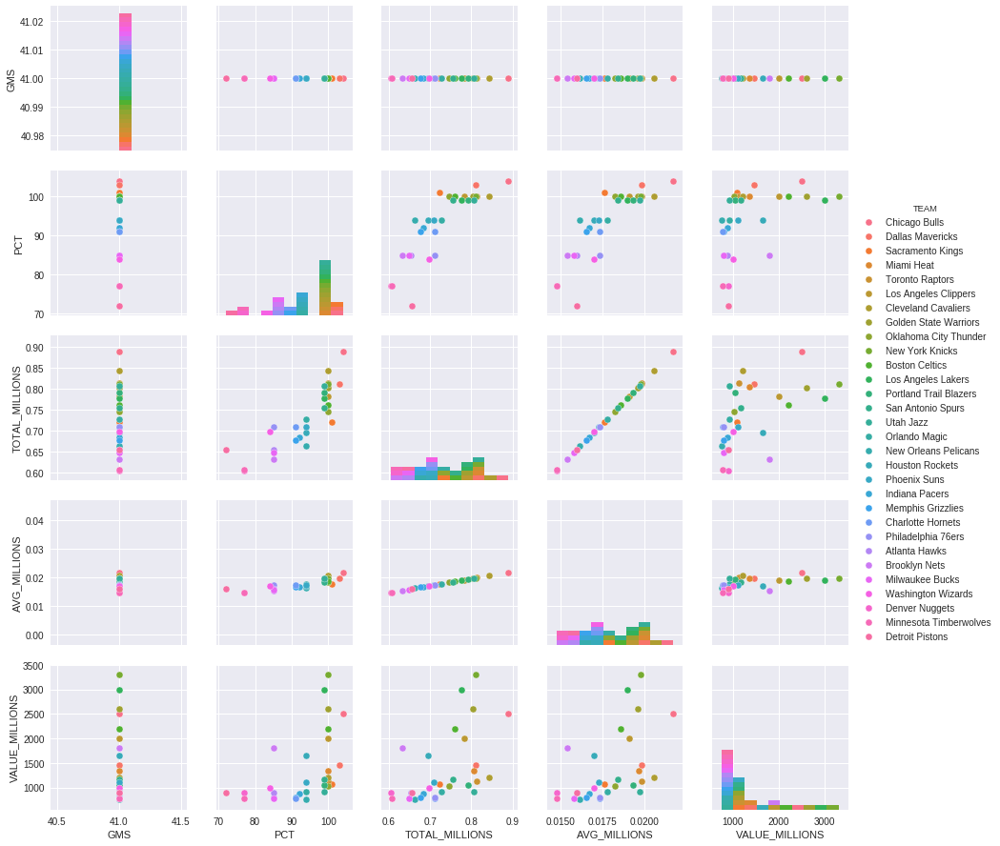

In [46]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"));sns.pairplot(attendance_valuation_df, hue="TEAM")

**Correlation Heatmap**

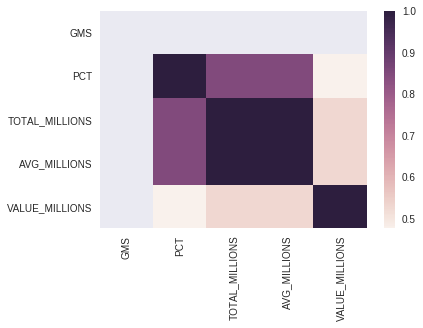

In [47]:
corr = attendance_valuation_df.corr()
sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values)

**Correlation DataFrame Output**

In [48]:
corr

,GMS,PCT,TOTAL_MILLIONS,AVG_MILLIONS,VALUE_MILLIONS
GMS,NaN,NaN,NaN,NaN,NaN
PCT,NaN,1.000000,0.850839,0.85085,0.476644
TOTAL_MILLIONS,NaN,0.850839,1.000000,1.00000,0.530697
AVG_MILLIONS,NaN,0.850850,1.000000,1.00000,0.530730
VALUE_MILLIONS,NaN,0.476644,0.530697,0.53073,1.000000


**Creating a Pivot Table Based Heatmap in Seaborn**

A few patterns are detected:  Look at the *three highest valued signals*

In [0]:
valuations = attendance_valuation_df.pivot("TEAM", "TOTAL_MILLIONS", "VALUE_MILLIONS")

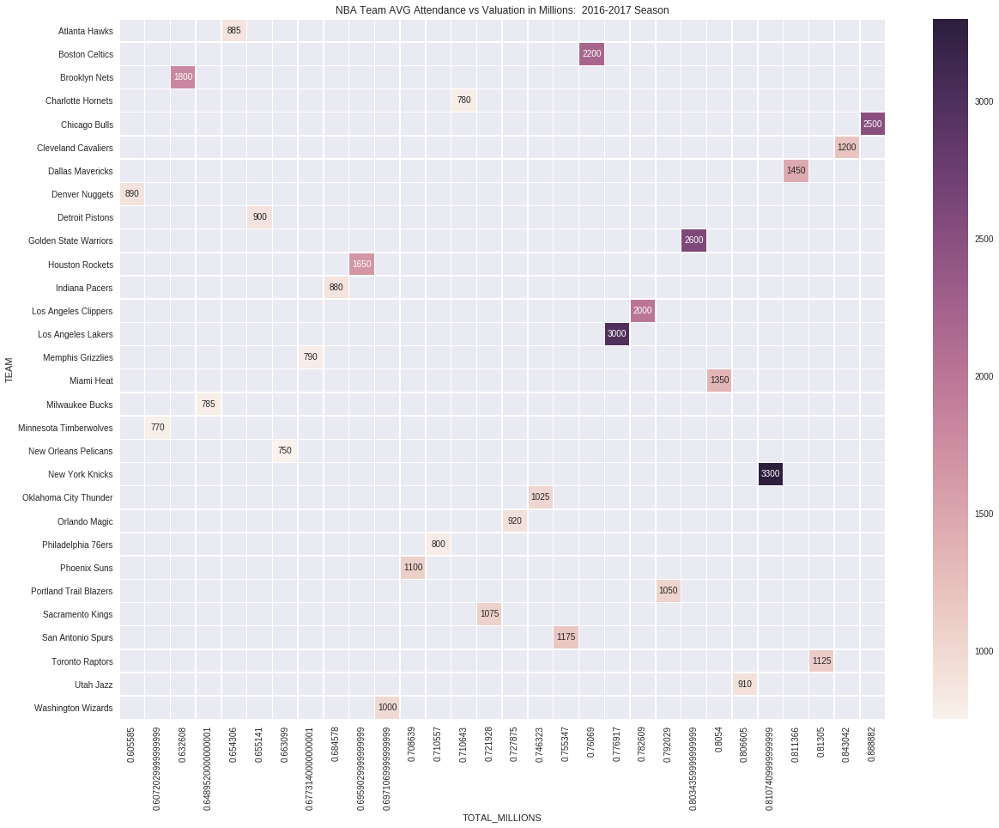

In [50]:
plt.subplots(figsize=(20,15))
ax = plt.axes()
ax.set_title("NBA Team AVG Attendance vs Valuation in Millions:  2016-2017 Season")
sns.heatmap(valuations,linewidths=.5, annot=True, fmt='g')

#### Using linear regression in Python

There is a signal here, attendence and valuation do seem to be related, but residual values look non-uniform.

In [0]:
results = smf.ols('VALUE_MILLIONS ~TOTAL_MILLIONS', data=attendance_valuation_df).fit()

In [52]:
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:         VALUE_MILLIONS   R-squared:                       0.282
Model:                            OLS   Adj. R-squared:                  0.256
Method:                 Least Squares   F-statistic:                     10.98
Date:                Sun, 29 Jul 2018   Prob (F-statistic):            0.00255
Time:                        16:51:51   Log-Likelihood:                -234.04
No. Observations:                  30   AIC:                             472.1
Df Residuals:                      28   BIC:                             474.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept      -2408.0191   1141.332     -2.

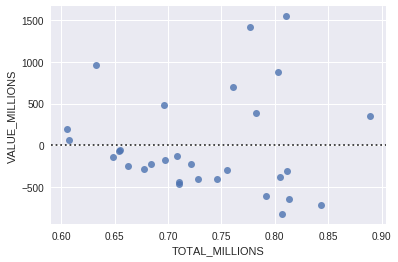

In [53]:
sns.residplot(y="VALUE_MILLIONS", x="TOTAL_MILLIONS", data=attendance_valuation_df)

In [0]:
attendance_valuation_predictions_df = attendance_valuation_df.copy()

In [0]:
attendance_valuation_predictions_df["predicted"] = results.predict()

#### Use seaborn lmplot to plot predicted vs actual values

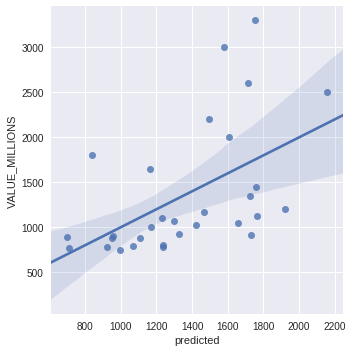

In [56]:
sns.lmplot(x="predicted", y="VALUE_MILLIONS", data=attendance_valuation_predictions_df)

##### Generating a RMSE (Root Mean Squared Error Prediction)

In [57]:
import statsmodels
rmse = statsmodels.tools.eval_measures.rmse(attendance_valuation_predictions_df["predicted"], attendance_valuation_predictions_df["VALUE_MILLIONS"])
rmse

591.332190174427

#### Adding ELO (Strength of Schedule Ranking to DataFrame)

In [0]:
attendance_valuation_elo_df = attendance_valuation_df.merge(elo_df, how="inner", on="TEAM")

In [59]:
attendance_valuation_elo_df.head()

,TEAM,GMS,PCT,TOTAL_MILLIONS,AVG_MILLIONS,VALUE_MILLIONS,ELO,CONF
0,Chicago Bulls,41,104,0.888882,0.021680,2500.0,1519,East
1,Dallas Mavericks,41,103,0.811366,0.019789,1450.0,1420,West
2,Sacramento Kings,41,101,0.721928,0.017608,1075.0,1393,West
3,Miami Heat,41,100,0.805400,0.019643,1350.0,1569,East
4,Toronto Raptors,41,100,0.813050,0.019830,1125.0,1600,East


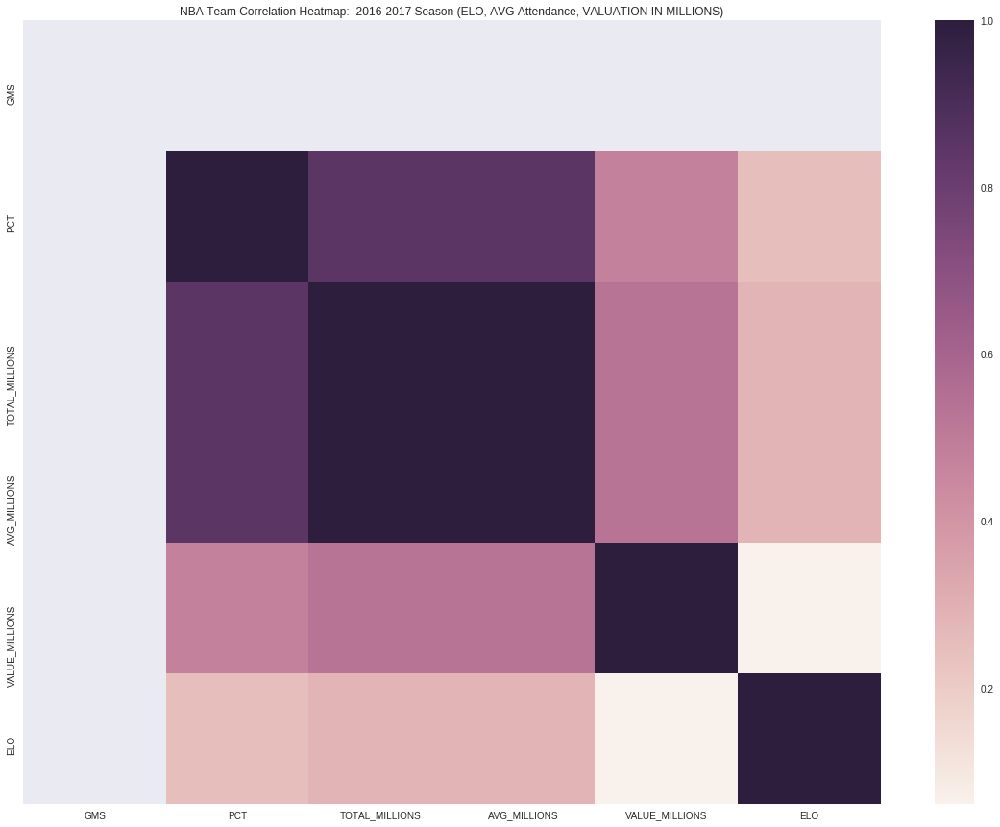

In [60]:
corr_elo = attendance_valuation_elo_df.corr()
plt.subplots(figsize=(20,15))
ax = plt.axes()
ax.set_title("NBA Team Correlation Heatmap:  2016-2017 Season (ELO, AVG Attendance, VALUATION IN MILLIONS)")
sns.heatmap(corr_elo, 
            xticklabels=corr_elo.columns.values,
            yticklabels=corr_elo.columns.values)

In [61]:
corr_elo

,GMS,PCT,TOTAL_MILLIONS,AVG_MILLIONS,VALUE_MILLIONS,ELO
GMS,NaN,NaN,NaN,NaN,NaN,NaN
PCT,NaN,1.000000,0.850839,0.85085,0.476644,0.251144
TOTAL_MILLIONS,NaN,0.850839,1.000000,1.00000,0.530697,0.285907
AVG_MILLIONS,NaN,0.850850,1.000000,1.00000,0.530730,0.285930
VALUE_MILLIONS,NaN,0.476644,0.530697,0.53073,1.000000,0.060575
ELO,NaN,0.251144,0.285907,0.28593,0.060575,1.000000


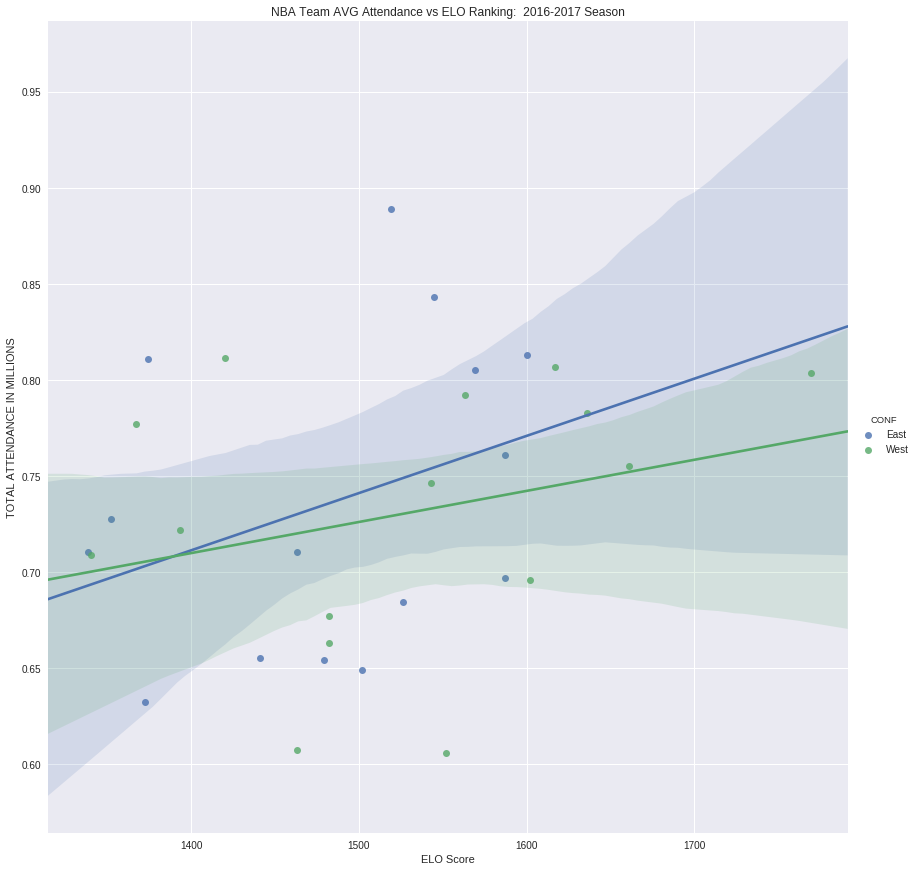

In [62]:
ax = sns.lmplot(x="ELO", y="TOTAL_MILLIONS", data=attendance_valuation_elo_df, hue="CONF", size=12)
ax.set(xlabel='ELO Score', ylabel='TOTAL ATTENDANCE IN MILLIONS', title="NBA Team AVG Attendance vs ELO Ranking:  2016-2017 Season")

In [63]:
attendance_valuation_elo_df.groupby("CONF")["ELO"].median()


CONF
East    1502
West    1543
Name: ELO, dtype: int64

In [64]:
attendance_valuation_elo_df.groupby("CONF")["TOTAL_MILLIONS"].median()

CONF
East    0.710643
West    0.746323
Name: TOTAL_MILLIONS, dtype: float64

In [0]:
results = smf.ols('TOTAL_MILLIONS ~ELO', data=attendance_valuation_elo_df).fit()


In [66]:
print(results.summary())
      


                            OLS Regression Results                            
Dep. Variable:         TOTAL_MILLIONS   R-squared:                       0.082
Model:                            OLS   Adj. R-squared:                  0.049
Method:                 Least Squares   F-statistic:                     2.493
Date:                Sun, 29 Jul 2018   Prob (F-statistic):              0.126
Time:                        16:52:00   Log-Likelihood:                 37.584
No. Observations:                  30   AIC:                            -71.17
Df Residuals:                      28   BIC:                            -68.37
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.4378      0.188      2.334      0.0

In [67]:
val_housing_win_df = pd.read_csv("../data/nba_2017_att_val_elo_win_housing.csv");val_housing_win_df.head()

,TEAM,GMS,PCT_ATTENDANCE,WINNING_SEASON,TOTAL_ATTENDANCE_MILLIONS,VALUE_MILLIONS,ELO,CONF,COUNTY,MEDIAN_HOME_PRICE_COUNTY_MILLIONS,COUNTY_POPULATION_MILLIONS
0,Chicago Bulls,41,104,1,0.888882,2500,1519,East,Cook,269900.0,5.20
1,Dallas Mavericks,41,103,0,0.811366,1450,1420,West,Dallas,314990.0,2.57
2,Sacramento Kings,41,101,0,0.721928,1075,1393,West,Sacremento,343950.0,1.51
3,Miami Heat,41,100,1,0.805400,1350,1569,East,Miami-Dade,389000.0,2.71
4,Toronto Raptors,41,100,1,0.813050,1125,1600,East,York-County,390000.0,1.10


In [68]:
val_housing_win_df.columns

Index(['TEAM', 'GMS', 'PCT_ATTENDANCE', 'WINNING_SEASON',
       'TOTAL_ATTENDANCE_MILLIONS', 'VALUE_MILLIONS', 'ELO', 'CONF', 'COUNTY',
       'MEDIAN_HOME_PRICE_COUNTY_MILLIONS', 'COUNTY_POPULATION_MILLIONS'],
      dtype='object')

In [69]:
results = smf.ols('VALUE_MILLIONS ~COUNTY_POPULATION_MILLIONS+TOTAL_ATTENDANCE_MILLIONS+MEDIAN_HOME_PRICE_COUNTY_MILLIONS', data=val_housing_win_df).fit()
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:         VALUE_MILLIONS   R-squared:                       0.811
Model:                            OLS   Adj. R-squared:                  0.789
Method:                 Least Squares   F-statistic:                     37.12
Date:                Sun, 29 Jul 2018   Prob (F-statistic):           1.52e-09
Time:                        16:52:02   Log-Likelihood:                -214.03
No. Observations:                  30   AIC:                             436.1
Df Residuals:                      26   BIC:                             441.7
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                                        coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------
Interc

#### Using ggplot in Python

In [70]:
!pip install ggplot

    100% |████████████████████████████████| 2.2MB 6.9MB/s 


/usr/local/lib/python3.6/dist-packages/ggplot/utils.py:81: FutureWarning: pandas.tslib is deprecated and will be removed in a future version.
You can access Timestamp as pandas.Timestamp
  pd.tslib.Timestamp,
/usr/local/lib/python3.6/dist-packages/ggplot/stats/smoothers.py:4: FutureWarning: The pandas.lib module is deprecated and will be removed in a future version. These are private functions and can be accessed from pandas._libs.lib instead
  from pandas.lib import Timestamp


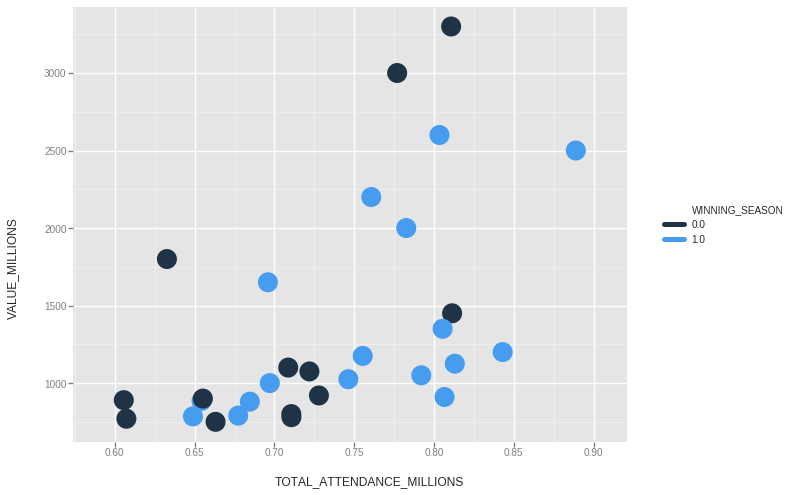

<ggplot: (-9223363264191170651)>

In [71]:
from ggplot import *
ggplot(val_housing_win_df, aes(x="TOTAL_ATTENDANCE_MILLIONS", y="VALUE_MILLIONS",
                               color="WINNING_SEASON")) + geom_point(size=400)

#### Use k-means clustering

**Unsupervised Machine Learning**

*   Unlabeled Data
*   "Discovers" Labels
*  Finds Hidden Patterns


**References:**



1.  [Pragmatic AI](https://www.safaribooksonline.com/library/view/pragmatic-ai-an/9780134863924/ch06.html#ch06) 
2.   [Python Machine Learning](https://www.safaribooksonline.com/library/view/Python+Machine+Learning+-+Second+Edition/9781787125933/ch11.html#ch11lvl2sec114)




*NBA Season Faceted Cluster Plot *

![Discovering Clusters in the NBA](https://user-images.githubusercontent.com/58792/40759110-6a93a2f8-6445-11e8-980b-ecbb1a2cc029.png)

**Data Preparation for Clustering**

* Clustering on four columns:  Attendence, ELO, Valuation and Median Home Prices
* Scaling the data


In [0]:
numerical_df = val_housing_win_df.loc[:,["TOTAL_ATTENDANCE_MILLIONS", "ELO", "VALUE_MILLIONS", "MEDIAN_HOME_PRICE_COUNTY_MILLIONS"]]

In [73]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
print(scaler.fit(numerical_df))
print(scaler.transform(numerical_df))

MinMaxScaler(copy=True, feature_range=(0, 1))
[[1.         0.41898148 0.68627451 0.08776879]
 [0.72637903 0.18981481 0.2745098  0.11603661]
 [0.41067502 0.12731481 0.12745098 0.13419221]
 [0.70531986 0.53472222 0.23529412 0.16243496]
 [0.73232332 0.60648148 0.14705882 0.16306188]
 [0.62487072 0.68981481 0.49019608 0.31038806]
 [0.83819102 0.47916667 0.17647059 0.00476459]
 [0.6983872  1.         0.7254902  0.39188139]
 [0.49678606 0.47453704 0.10784314 0.04993825]
 [0.72417286 0.08333333 1.         1.        ]
 [0.54749962 0.57638889 0.56862745 0.23139615]
 [0.60477873 0.06712963 0.88235294 0.31038806]
 [0.65812204 0.52083333 0.11764706 0.184816  ]
 [0.52863955 0.74768519 0.16666667 0.08156228]
 [0.70957335 0.64583333 0.0627451  0.13983449]
 [0.43166712 0.03240741 0.06666667 0.10657639]
 [0.20301662 0.33333333 0.         0.10350448]
 [0.31881029 0.61111111 0.35294118 0.09062441]
 [0.36376665 0.00462963 0.1372549  0.10350448]
 [0.27883458 0.43518519 0.05098039 0.00946649]
 [0.25319364 0

In [74]:
from sklearn.cluster import KMeans
k_means = KMeans(n_clusters=3)
kmeans = k_means.fit(scaler.transform(numerical_df))
val_housing_win_df['cluster'] = kmeans.labels_
val_housing_win_df.head()

,TEAM,GMS,PCT_ATTENDANCE,WINNING_SEASON,TOTAL_ATTENDANCE_MILLIONS,VALUE_MILLIONS,ELO,CONF,COUNTY,MEDIAN_HOME_PRICE_COUNTY_MILLIONS,COUNTY_POPULATION_MILLIONS,cluster
0,Chicago Bulls,41,104,1,0.888882,2500,1519,East,Cook,269900.0,5.20,0
1,Dallas Mavericks,41,103,0,0.811366,1450,1420,West,Dallas,314990.0,2.57,0
2,Sacramento Kings,41,101,0,0.721928,1075,1393,West,Sacremento,343950.0,1.51,1
3,Miami Heat,41,100,1,0.805400,1350,1569,East,Miami-Dade,389000.0,2.71,0
4,Toronto Raptors,41,100,1,0.813050,1125,1600,East,York-County,390000.0,1.10,0


**2D Cluster Plot**

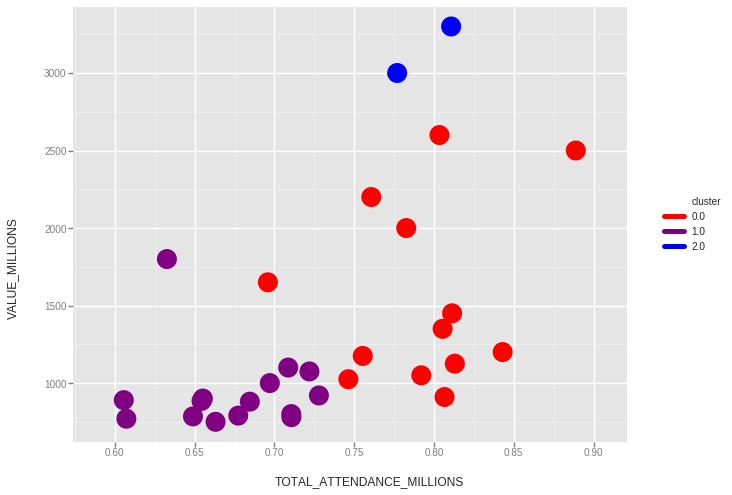

<ggplot: (8772662494984)>

In [75]:
from ggplot import *
ggplot(val_housing_win_df, aes(x="TOTAL_ATTENDANCE_MILLIONS", y="VALUE_MILLIONS", color="cluster")) +\
geom_point(size=400) + scale_color_gradient(low = 'red', high = 'blue')

 Elbow method shows that 3 clusters is decent choice

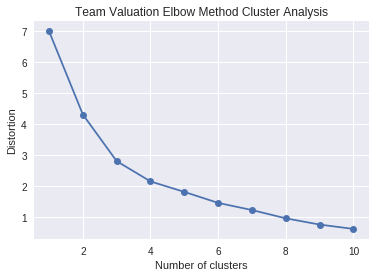

In [76]:
distortions = []
for i in range(1, 11):
    km = KMeans(n_clusters=i,
            init='k-means++',
            n_init=10,
            max_iter=300,
            random_state=0)
    km.fit(scaler.transform(numerical_df))
    distortions.append(km.inertia_)
    
plt.plot(range(1,11), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.title("Team Valuation Elbow Method Cluster Analysis")
plt.show()

##### Silhouette Plot



In [0]:
km = KMeans(n_clusters=3,
            init='k-means++',
            n_init=10,
            max_iter=300,
            random_state=0)
y_km = km.fit_predict(scaler.transform(numerical_df))

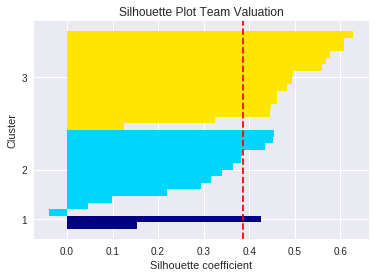

In [78]:
import numpy as np
from matplotlib import cm
from sklearn.metrics import silhouette_samples
cluster_labels = np.unique(y_km)
n_clusters = cluster_labels.shape[0]
silhouette_vals = silhouette_samples(scaler.transform(numerical_df),
                                     y_km,
                                     metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []
for i, c in enumerate(cluster_labels):
    c_silhouette_vals = silhouette_vals[y_km == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = cm.jet(float(i)/n_clusters)
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, edgecolor='none',color=color)
    yticks.append((y_ax_lower + y_ax_upper)/2)
    y_ax_lower += len(c_silhouette_vals)
silhouette_avg = np.mean(silhouette_vals)
plt.axvline(silhouette_avg,
            color="red",
            linestyle="--")
plt.yticks(yticks, cluster_labels + 1)
plt.ylabel('Cluster')
plt.xlabel('Silhouette coefficient')
plt.title('Silhouette Plot Team Valuation')
plt.figure(figsize=(20,10))
plt.show()

##### Agglomerative clustering (Hierachial) vs KMeans clustering


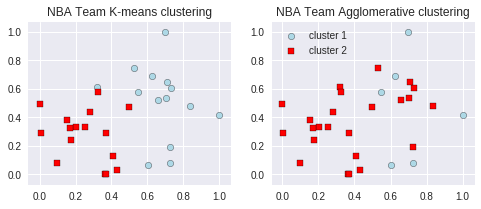

In [79]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 3))
km = KMeans(n_clusters=2,
            random_state=0)
X = scaler.transform(numerical_df)
y_km = km.fit_predict(X)
ax1.scatter(X[y_km==0,0],
            X[y_km==0,1],
            c='lightblue',
            edgecolor='black',
            marker='o',
            s=40,
            label='cluster 1')
ax1.scatter(X[y_km==1,0],
            X[y_km==1,1],
            c='red',
            edgecolor='black',
            marker='s',
            s=40,
            label='cluster 2')
ax1.set_title('NBA Team K-means clustering')
from sklearn.cluster import AgglomerativeClustering

X = scaler.transform(numerical_df)
ac = AgglomerativeClustering(n_clusters=2,
                             affinity='euclidean',
                             linkage='complete')
y_ac = ac.fit_predict(X)
ax2.scatter(X[y_ac==0,0],
             X[y_ac==0,1],
             c='lightblue',
             edgecolor='black',
             marker='o',
            s=40,
            label='cluster 1')
ax2.scatter(X[y_ac==1,0],
            X[y_ac==1,1],
            c='red',
            edgecolor='black',
            marker='s',
            s=40,
            label='cluster 2')
ax2.set_title('NBA Team Agglomerative clustering')
plt.legend()
plt.show()

##### 3D Plot in R

![Valuation 3D Plot](https://user-images.githubusercontent.com/58792/36056809-7f87a266-0dbc-11e8-8877-9bb87905adbd.png)

Source Code:  https://github.com/noahgift/socialpowernba/blob/master/plot_team_cluster.R

#### Use PCA with sklearn

References:



1.  [ PCA sklearn](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)





In [80]:
import pandas as pd
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca.fit(numerical_df)
X = pca.transform(numerical_df)
print(f"Before PCA Reduction{numerical_df.shape}")
print(f"After PCA Reduction {X.shape}")

Before PCA Reduction(30, 4)
After PCA Reduction (30, 2)


##### Simple Scatter Plot of Reduced Dimensions

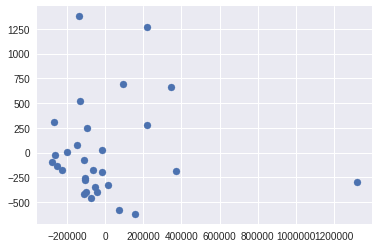

In [81]:
plt.scatter(X[:, 0], X[:, 1])
plt.show()


#### Use ML classification prediction with scikit-learn

Create supervized classification prediction

In [0]:
from sklearn.neighbors import KNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit?

#### ML Regression prediction with scikit-learn

Create supervized regression prediction

In [0]:
from sklearn.neighbors import KNeighborsRegressor
neigh = KNeighborsRegressor(n_neighbors=2)
neigh.fit?


#### Using Plotly for interactive Data Visualization

*[Read related material covered in Chapter 10 of Pragmatic AI](https://www.safaribooksonline.com/library/view/pragmatic-ai-an/9780134863924/ch10.xhtml#ch10)*

Cell configuration to setup Plotly
Further documentation available from [Google on Plotly Colab Integration](https://colab.research.google.com/notebooks/charts.ipynb#scrollTo=YVhMPxwa-wmS)



In [0]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))


##### Going Further with Real Estate Exploration

In [85]:
import pandas as pd
pd.set_option('display.float_format', lambda x: '%.3f' % x)
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn as sns; sns.set(color_codes=True)
from sklearn.cluster import KMeans
color = sns.color_palette()
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
%matplotlib inline

In [0]:
df = pd.read_csv("../data/Zip_Zhvi_SingleFamilyResidence.csv")

In [87]:
df.describe()

,RegionID,RegionName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,...,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09
count,15282.000,15282.000,15282.000,10843.000,10974.000,10998.000,11005.000,11018.000,11018.000,11018.000,...,15232.000,15282.000,15282.000,15282.000,15282.000,15282.000,15282.000,15282.000,15282.000,15282.000
mean,80125.483,46295.286,7641.500,123036.189,122971.396,122955.756,122978.601,123053.295,123168.660,123334.779,...,258309.913,259161.098,260118.846,261045.308,261971.018,262927.640,263803.226,264618.329,265565.816,266395.956
std,30816.445,28934.030,4411.678,78308.265,77822.431,77728.750,77712.302,77681.914,77730.936,77814.034,...,286788.579,287657.252,287840.275,287918.491,288476.692,289147.943,289719.317,290338.071,291066.856,291579.369
min,58196.000,1001.000,1.000,24400.000,23900.000,24200.000,24700.000,24700.000,25100.000,25300.000,...,31800.000,32100.000,31900.000,31200.000,30600.000,30600.000,30900.000,31400.000,32600.000,32700.000
25%,66785.250,21087.750,3821.250,75700.000,75900.000,76000.000,76000.000,76200.000,76225.000,76300.000,...,122100.000,122500.000,123100.000,123700.000,124100.000,124700.000,125100.000,125600.000,126025.000,126500.000
50%,77175.000,44306.500,7641.500,104300.000,104450.000,104500.000,104600.000,104900.000,105000.000,105100.000,...,176800.000,177400.000,178300.000,179200.000,179900.000,180600.000,181300.000,182000.000,182500.000,183100.000
75%,88700.500,70399.500,11461.750,147100.000,147200.000,147100.000,147400.000,147475.000,147575.000,147600.000,...,288425.000,289200.000,290300.000,291375.000,292300.000,293400.000,294800.000,296000.000,297400.000,298750.000
max,738092.000,99901.000,15282.000,1769000.000,1768100.000,1766900.000,1764200.000,1762200.000,1762600.000,1763900.000,...,6299300.000,6360300.000,6336400.000,6255500.000,6294300.000,6403700.000,6468900.000,6489100.000,6492000.000,6475600.000


**Clean Up DataFrame**
Rename RegionName to ZipCode and Change Zip Code to String



In [88]:
df.rename(columns={"RegionName":"ZipCode"}, inplace=True)
df["ZipCode"]=df["ZipCode"].map(lambda x: "{:.0f}".format(x))
df["RegionID"]=df["RegionID"].map(lambda x: "{:.0f}".format(x))
df.head()

,RegionID,ZipCode,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,...,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09
0,84654,60657,Chicago,IL,Chicago,Cook,1.000,420800.000,423500.000,426200.000,...,1097900.000,1098300.000,1094700.000,1088500.000,1081200.000,1073900.000,1064300.000,1054300.000,1048500.000,1044400.000
1,84616,60614,Chicago,IL,Chicago,Cook,2.000,542400.000,546700.000,551700.000,...,1522800.000,1525900.000,1525000.000,1526100.000,1528700.000,1526700.000,1518900.000,1515800.000,1519900.000,1525300.000
2,93144,79936,El Paso,TX,El Paso,El Paso,3.000,70900.000,71200.000,71100.000,...,114200.000,114300.000,114200.000,114000.000,113800.000,114000.000,114000.000,113800.000,113500.000,113300.000
3,84640,60640,Chicago,IL,Chicago,Cook,4.000,298200.000,297400.000,295300.000,...,739400.000,743100.000,741500.000,736300.000,729500.000,727700.000,726000.000,718800.000,713400.000,710900.000
4,61807,10467,New York,NY,New York,Bronx,5.000,nan,nan,nan,...,391600.000,388900.000,388800.000,391100.000,394400.000,396900.000,398600.000,400500.000,402600.000,403700.000


In [0]:
median_prices = df.median()

In [90]:
median_prices.tail()

2017-05   180600.000
2017-06   181300.000
2017-07   182000.000
2017-08   182500.000
2017-09   183100.000
dtype: float64

In [0]:
marin_df = df[df["CountyName"] == "Marin"].median()
sf_df = df[df["City"] == "San Francisco"].median()
palo_alto = df[df["City"] == "Palo Alto"].median()
df_comparison = pd.concat([marin_df, sf_df, palo_alto, median_prices], axis=1)
df_comparison.columns = ["Marin County", "San Francisco", "Palo Alto", "Median USA"]

Install **Cufflinks**

In [92]:
!pip install cufflinks

    100% |████████████████████████████████| 61kB 1.9MB/s 
    100% |████████████████████████████████| 30.3MB 878kB/s 
  Running setup.py bdist_wheel for cufflinks ... - done
  Stored in directory: /content/.cache/pip/wheels/10/78/8f/c9085ae409e556466c35584178fa7c3145c3265e7f324817fb
  Running setup.py bdist_wheel for plotly ... - \ | / - \ | / - \ | / - \ | / - \ | /

 - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ done
  Stored in directory: /content/.cache/pip/wheels/9f/8c/a4/a1a26a9a0ac42d852e0fb4b0ba021cc6b881aab075d03e903b
  Running setup.py bdist_wheel for colorlover ... - done
  Stored in directory: /content/.cache/pip/wheels/fc/c3/f7/fde32e0d906ad64fe8011a823ea39e0197616116150f4a8376
  Running setup.py bdist_wheel for retrying ... - done
  Stored in directory: /content/.cache/pip/wheels/d7/a9/33/acc7b709e2a35caa7d4cae442f6fe6fbf2c43f80823d46460c
Successfully built cufflinks plotly colorlover retrying
  Found existing installation: plotly 1.12.12
    Uninstalling plotly-1.12.12:
      Successfully uninstalled plotly-1.12.12


**Plotly visualization**

[Shortcut view of plot if slow to load](http://nbviewer.jupyter.org/github/noahgift/real_estate_ml/blob/648361ce7392a0af29ce79780e6e5159c1a378e9/notebooks/explore_zillow_data_sets.ipynb)

In [93]:
import cufflinks as cf
cf.go_offline()

from plotly.offline import init_notebook_mode
configure_plotly_browser_state()
init_notebook_mode(connected=False)


df_comparison.iplot(title="Bay Area Median Single Family Home Prices 1996-2017",
                    xTitle="Year",
                    yTitle="Sales Price",
                   #bestfit=True, bestfit_colors=["pink"],
                   #subplots=True,
                   shape=(4,1),
                    #subplot_titles=True,
                    fill=True,)

/usr/local/lib/python3.6/dist-packages/plotly/graph_objs/_deprecations.py:558: DeprecationWarning:

plotly.graph_objs.YAxis is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.YAxis
  - plotly.graph_objs.layout.scene.YAxis


/usr/local/lib/python3.6/dist-packages/plotly/graph_objs/_deprecations.py:531: DeprecationWarning:

plotly.graph_objs.XAxis is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.XAxis
  - plotly.graph_objs.layout.scene.XAxis




ValueError: ignored

**Cluster on Size Rank and Price**

In [0]:
from sklearn.preprocessing import MinMaxScaler

In [0]:
columns_to_drop = ['RegionID', 'ZipCode', 'City', 'State', 'Metro', 'CountyName']
df_numerical = df.dropna()
df_numerical = df_numerical.drop(columns_to_drop, axis=1)

In [128]:
df_numerical.describe()

,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,...,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09
count,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,...,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000,10015.000
mean,6901.275,124233.839,124346.890,124445.791,124517.993,124594.988,124709.356,124879.700,125125.172,125469.755,...,275726.231,277007.289,278042.496,279015.157,279936.805,280915.696,281880.929,282792.521,283862.696,284821.967
std,4300.338,78083.175,77917.627,77830.951,77776.606,77746.268,77742.096,77791.639,77894.556,78146.593,...,272648.369,273619.541,273787.430,273932.988,274594.533,275399.805,276184.285,276903.768,277813.140,278583.832
min,1.000,24500.000,24500.000,24800.000,24800.000,24700.000,25100.000,25600.000,26000.000,26200.000,...,35600.000,35000.000,34200.000,33800.000,33800.000,33300.000,32900.000,32800.000,32800.000,32800.000
25%,3166.500,77200.000,77300.000,77300.000,77300.000,77500.000,77700.000,77800.000,77900.000,78100.000,...,135150.000,135950.000,136700.000,137300.000,138200.000,138750.000,139200.000,139800.000,140100.000,140700.000
50%,6578.000,105700.000,106100.000,106400.000,106400.000,106700.000,107000.000,107300.000,107500.000,107900.000,...,198400.000,199600.000,200700.000,202300.000,203300.000,204200.000,205200.000,206100.000,207200.000,207800.000
75%,10462.000,148000.000,148200.000,148500.000,148700.000,148900.000,148900.000,149000.000,149100.000,149600.000,...,319500.000,320700.000,322100.000,322800.000,323200.000,324250.000,325150.000,327000.000,328000.000,329500.000
max,15281.000,1769000.000,1768100.000,1766900.000,1764200.000,1762200.000,1762600.000,1763900.000,1763800.000,1764400.000,...,5566400.000,5589200.000,5615700.000,5645200.000,5696000.000,5743800.000,5769800.000,5744500.000,5706500.000,5676900.000


In [129]:
scaler = MinMaxScaler()
scaled_df = scaler.fit_transform(df_numerical)
kmeans = KMeans(n_clusters=3, random_state=0).fit(scaled_df)
print(len(kmeans.labels_))

10015


In [130]:
cluster_df = df.copy(deep=True)
cluster_df.dropna(inplace=True)
cluster_df.describe()
cluster_df['cluster'] = kmeans.labels_
cluster_df['appreciation_ratio'] = round(cluster_df["2017-09"]/cluster_df["1996-04"],2)
cluster_df['CityZipCodeAppRatio'] = cluster_df['City'].map(str) + "-" + cluster_df['ZipCode'] + "-" + cluster_df["appreciation_ratio"].map(str)
cluster_df.head()

,RegionID,ZipCode,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,...,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09,cluster,appreciation_ratio,CityZipCodeAppRatio
0,84654,60657,Chicago,IL,Chicago,Cook,1.000,420800.000,423500.000,426200.000,...,1088500.000,1081200.000,1073900.000,1064300.000,1054300.000,1048500.000,1044400.000,2,2.480,Chicago-60657-2.48
1,84616,60614,Chicago,IL,Chicago,Cook,2.000,542400.000,546700.000,551700.000,...,1526100.000,1528700.000,1526700.000,1518900.000,1515800.000,1519900.000,1525300.000,2,2.810,Chicago-60614-2.81
2,93144,79936,El Paso,TX,El Paso,El Paso,3.000,70900.000,71200.000,71100.000,...,114000.000,113800.000,114000.000,114000.000,113800.000,113500.000,113300.000,1,1.600,El Paso-79936-1.6
3,84640,60640,Chicago,IL,Chicago,Cook,4.000,298200.000,297400.000,295300.000,...,736300.000,729500.000,727700.000,726000.000,718800.000,713400.000,710900.000,0,2.380,Chicago-60640-2.38
5,91733,77084,Houston,TX,Houston,Harris,6.000,76700.000,76500.000,76000.000,...,154700.000,155500.000,158700.000,160600.000,161300.000,161800.000,161500.000,1,2.110,Houston-77084-2.11


**Create a 3D Plot**

[Shortcut view of plot if slow to load](http://nbviewer.jupyter.org/github/noahgift/real_estate_ml/blob/648361ce7392a0af29ce79780e6e5159c1a378e9/notebooks/explore_zillow_data_sets.ipynb)


In [131]:
import plotly.offline as py
import plotly.graph_objs as go

from plotly.offline import init_notebook_mode
configure_plotly_browser_state()
init_notebook_mode(connected=False)

trace1 = go.Scatter3d(
    x=cluster_df["appreciation_ratio"],
    y=cluster_df["1996-04"],
    z=cluster_df["2017-09"],
    mode='markers',
    text=cluster_df["CityZipCodeAppRatio"],
    marker=dict(
        size=12,
        color=cluster_df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="30 Year History USA Real Estate Prices (Clusters Colored)",
    scene = dict(
        xaxis = dict(title='X: Appreciation Ratio'),
        yaxis = dict(title="Y:  1996 Prices"),
        zaxis = dict(title="Z:  2017 Prices"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

**NBA Player Endorsements Interactive Plotly Graph**

Reference:

*   https://plot.ly/~ngift/17/






In [132]:
from plotly.offline import init_notebook_mode
configure_plotly_browser_state()
init_notebook_mode(connected=False)


import plotly.offline as py
from plotly.graph_objs import *
trace1 = {
  "x": ["LeBron James", "Kevin Durant", "James Harden", "Russell Westbrook", "Carmelo Anthony", "Dwyane Wade", "Chris Paul", "Derrick Rose", "Kyrie Irving", "Stephen Curry"], 
  "y": [55, 36, 20, 15, 8, 13, 8, 14, 13, 35], 
  "name": "Endorsements in Millions", 
  "type": "bar", 
  "uid": "df2707", 
  "xsrc": "ngift:16:53adec", 
  "ysrc": "ngift:16:0e0504"
}
trace2 = {
  "x": ["LeBron James", "Kevin Durant", "James Harden", "Russell Westbrook", "Carmelo Anthony", "Dwyane Wade", "Chris Paul", "Derrick Rose", "Kyrie Irving", "Stephen Curry"], 
  "y": [14.7, 6.29, 3.28, 4.28, 3.77, 4.67, 2.69, 3.27, 4.8, 17.57], 
  "name": "Wikipedia Pageviews", 
  "type": "bar", 
  "uid": "c9d073", 
  "xsrc": "ngift:16:53adec", 
  "ysrc": "ngift:16:fea27a"
}
trace3 = {
  "x": ["LeBron James", "Kevin Durant", "James Harden", "Russell Westbrook", "Carmelo Anthony", "Dwyane Wade", "Chris Paul", "Derrick Rose", "Kyrie Irving", "Stephen Curry"], 
  "y": [20.43, 12.24, 15.54, 17.34, 5.26, 2.52, 13.48, 1.17, 8.28, 18.8], 
  "name": "Wins Attributed to Player", 
  "type": "bar", 
  "uid": "cfe1ac", 
  "xsrc": "ngift:16:53adec", 
  "ysrc": "ngift:16:f3c87e"
}
trace4 = {
  "x": ["LeBron James", "Kevin Durant", "James Harden", "Russell Westbrook", "Carmelo Anthony", "Dwyane Wade", "Chris Paul", "Derrick Rose", "Kyrie Irving", "Stephen Curry"], 
  "y": [30.96, 26.5, 26.5, 26.5, 24.56, 23.2, 22.87, 21.32, 17.64, 12.11], 
  "name": "Salary in Millions", 
  "type": "bar", 
  "uid": "f83635", 
  "xsrc": "ngift:16:53adec", 
  "ysrc": "ngift:16:2cdf3e"
}
trace5 = {
  "x": ["LeBron James", "Kevin Durant", "James Harden", "Russell Westbrook", "Carmelo Anthony", "Dwyane Wade", "Chris Paul", "Derrick Rose", "Kyrie Irving", "Stephen Curry"], 
  "y": [5.53, 1.43, 0.97, 2.13, 0.72, 0.35, 0.83, 1.86, 1.54, 12.28], 
  "name": "Twitter Favorite Count/1000", 
  "type": "bar", 
  "uid": "9d1aad", 
  "xsrc": "ngift:16:53adec", 
  "ysrc": "ngift:16:191da9"
}
data = Data([trace1, trace2, trace3, trace4, trace5])
layout = {
  "barmode": "group", 
  "title": "2016-2017 NBA Season Endorsement and Social Power", 
  "xaxis": {
    "autorange": True, 
    "range": [-0.5, 9.5], 
    "type": "category"
  }, 
  "yaxis": {
    "autorange": True, 
    "range": [0, 57.8947368421], 
    "type": "linear"
  }
}
fig = Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

/usr/local/lib/python3.6/dist-packages/plotly/graph_objs/_deprecations.py:39: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histogram
  - etc.


